# Messing around with fastai - based on the fastbook content and fastai forum notes

```
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
```
Does some magic to setup my environment, here I'm looking to see how hard it was to do this manually. The first thing I'll do is load up `fastai` instead of `fastbook` so I still have all the fastai libraries at hand if I need any core or helper functions

In [1]:
!rm -rf /content/sample_data/birds #cleanup for new run

In [2]:
!pip install -Uqq fastai

In [3]:
from fastai.vision.all import *

Running `fastbook.setup_book??` showed that there was a boolean `IN_COLLAB` that called another function `fastbook.setup_colab()` to do the setup.
Inside `setup_collab` it sets a global variable `gdrive` to my current path, and then imports `google.collab` to use `drive` to mount my google drive. I can do this myself here.

The snippets below are mostly straight out the [fastbook source code in Github](https://github.com/fastai/course20/blob/master/fastbook/__init__.py) 

In [4]:
global gdrive
gdrive = Path('/content/gdrive/My Drive')
from google.colab import drive
if not gdrive.exists(): drive.mount(str(gdrive.parent))

In [5]:
path = Path.cwd()

In [6]:
path

Path('/content')

There is also a nice little function for pulling images from [Duck Duck Go](https://duckduckgo.com/) instead of having to sign up to Microsoft Azure to get a key to use the Bing API for image search

In [7]:
def search_images_ddg(term, max_images=200):
    "Search for `term` with DuckDuckGo and return a unique urls of about `max_images` images"
    assert max_images<1000
    url = 'https://duckduckgo.com/'
    res = urlread(url,data={'q':term})
    searchObj = re.search(r'vqd=([\d-]+)\&', res)
    assert searchObj
    requestUrl = url + 'i.js'
    params = dict(l='us-en', o='json', q=term, vqd=searchObj.group(1), f=',,,', p='1', v7exp='a')
    urls,data = set(),{'next':1}
    while len(urls)<max_images and 'next' in data:
        try:
            data = urljson(requestUrl,data=params)
            urls.update(L(data['results']).itemgot('image'))
            requestUrl = url + data['next']
        except (URLError,HTTPError): pass
        time.sleep(0.2)
    return L(urls)

This code has a reference to an `L` object from `fastcore`, which in [documentation on L](https://fastcore.fast.ai/#L) indicates the intention of it is to replace lists. I should dive deeper into this to understand more.

I originally wrote a [Trinidad hummingbird classifier](https://hummingbirds.azurewebsites.net) from a previous attempt at the fastai course, in honor my native country of Trinidad and Tobago. This time, since I'm now in Australia, and celebrating my 4th year as a Queenslander living in Brisbane, I wanted to take a look at classifying Brisbane birds. There are actually alot of them, I'll pick just a few that I actually have remembered seeing so I can do the data cleansing step with a fair level of confidence. I added three types of ducks as well, just to make it a little tougher I think, although I'm not sure if I know the differences myself so we will see how my cleansing activities fare. The names are based on [this list](https://birdsqueensland.org.au/downloads/birds_list_BrisbaneChecklist.pdf). Let's start with the most famous one, the kookaburra.

In [8]:
kookaburra_bird_images = search_images_ddg("laughing kookaburra bird")
kookaburra_bird_images[0]

'http://www.glenchilton.com/wp-content/uploads/2014/09/laughing_kookaburra_Ian-Montgomery-birdway-com-au.jpg'

In [9]:
type(kookaburra_bird_images)

fastcore.foundation.L

In [10]:
type(kookaburra_bird_images[0])

str

There's a method `attrgot()` that is used to extract the file names from a column when doing this with Bing in [Lesson 2](https://github.com/fastai/fastbook/blob/master/02_production.ipynb) I read up the [documentation](https://fastcore.fast.ai/foundation.html#L.attrgot) on and got further clarification on fastai forums [here](https://forums.fast.ai/t/l-attrgot/77678). Duck Duck Go returns just strings, so there's no need to extract a column attribute here.

In [11]:
path.ls()

(#3) [Path('/content/.config'),Path('/content/gdrive'),Path('/content/sample_data')]

In [12]:
dest = path/'sample_data/kookaburra_bird.jpg'
download_url(kookaburra_bird_images[0], dest)

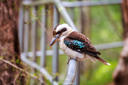

In [13]:
im = Image.open(dest)
im.to_thumb(128,128)

In [14]:
brisbane_bird_types = "kookaburra","magpie goose","australian white ibis", "australian pelican", "pacific black duck", "plumed whistling duck", "australian wood duck"
path = path/'sample_data/birds'
path

Path('/content/sample_data/birds')

In [15]:
if not path.exists():
    path.mkdir()
path

Path('/content/sample_data/birds')

In [16]:
path.ls()

(#0) []

It may take some time to run with the default of 200 images.

In [17]:
for o in brisbane_bird_types:
  dest = (path/o)
  dest.mkdir(exist_ok=True)
  results = search_images_ddg(f'{o} bird')
  download_images(dest, urls=results)


 Download of http://www.environment.nsw.gov.au/images/nature/white_ibisLg.jpg has failed after 5 retries
 Fix the download manually:
$ mkdir -p /content/sample_data/birds/australian white ibis
$ cd /content/sample_data/birds/australian white ibis
$ wget -c http://www.environment.nsw.gov.au/images/nature/white_ibisLg.jpg
$ tar xf white_ibisLg.jpg
 And re-run your code once the download is successful



Let's verify we got images as we expected

In [18]:
path.ls()

(#7) [Path('/content/sample_data/birds/kookaburra'),Path('/content/sample_data/birds/magpie goose'),Path('/content/sample_data/birds/australian pelican'),Path('/content/sample_data/birds/australian white ibis'),Path('/content/sample_data/birds/pacific black duck'),Path('/content/sample_data/birds/plumed whistling duck'),Path('/content/sample_data/birds/australian wood duck')]

In [19]:
!ls "sample_data/birds"

'australian pelican'	  kookaburra	       'plumed whistling duck'
'australian white ibis'  'magpie goose'
'australian wood duck'	 'pacific black duck'


In [70]:
get_image_files??

In [20]:
fns = get_image_files(path)
fns

(#1735) [Path('/content/sample_data/birds/kookaburra/00000173.jpg'),Path('/content/sample_data/birds/kookaburra/00000145.jpg'),Path('/content/sample_data/birds/kookaburra/00000195.jpg'),Path('/content/sample_data/birds/kookaburra/00000044.jpg'),Path('/content/sample_data/birds/kookaburra/00000047.jpg'),Path('/content/sample_data/birds/kookaburra/00000143.jpg'),Path('/content/sample_data/birds/kookaburra/00000101.jpg'),Path('/content/sample_data/birds/kookaburra/00000188.jpg'),Path('/content/sample_data/birds/kookaburra/00000158.jpg'),Path('/content/sample_data/birds/kookaburra/00000074.jpg')...]

In [21]:
len(fns)

1735

Check for the corrupt images

In [22]:
failed = verify_images(fns)
failed

(#4) [Path('/content/sample_data/birds/kookaburra/00000034.jpg'),Path('/content/sample_data/birds/kookaburra/00000217.jpg'),Path('/content/sample_data/birds/australian pelican/00000240.jpg'),Path('/content/sample_data/birds/australian white ibis/00000119.jpg')]

Remove corrupted images

In [23]:
failed.map(Path.unlink);

I'm going to bring forward the steps to clean up the data here from the book before cleaning, since I'm pretty sure some of these aren't going to be bird images so I want to get rid of them. Since we don't have a classifier yet, we're going to have to use [ImagesCleaner](https://docs.fast.ai/vision.widgets.html#ImagesCleaner) to do this pre-training cleaning step

In [24]:
from fastai.vision.widgets import *

We need the widgets to do cleanup. Reference [this forum post](https://forums.fast.ai/t/fastai2s-imageclassifiercleaner-to-clean-image-data-is-not-showing-up-in-colab/66125/6) 

We need to see how to browse the individual directories since I don't think ImagesCleaner gives that directory selector that the ImageClassifierCleaner module does, so let's peek at how that works

In [48]:
ImageClassifierCleaner??

In [50]:
ImagesCleaner??

In [25]:
path.cwd()

Path('/content')

In [26]:
path = Path('sample_data/birds')

In [27]:
path.ls()

(#7) [Path('sample_data/birds/kookaburra'),Path('sample_data/birds/magpie goose'),Path('sample_data/birds/australian pelican'),Path('sample_data/birds/australian white ibis'),Path('sample_data/birds/pacific black duck'),Path('sample_data/birds/plumed whistling duck'),Path('sample_data/birds/australian wood duck')]

Rerun the next three cells substituting the different categories of `kookaburra` with `magpie goose`,`australian white ibis`, `australian pelican`, `pacific black duck`, `plumed whistling duck`, `australian wood duck` to do some initial pre-training cleaning of possibly irrelevant images from search engine

In [28]:
fns_to_clean = get_image_files(path/'kookaburra')
fns_to_clean

(#234) [Path('sample_data/birds/kookaburra/00000173.jpg'),Path('sample_data/birds/kookaburra/00000145.jpg'),Path('sample_data/birds/kookaburra/00000195.jpg'),Path('sample_data/birds/kookaburra/00000044.jpg'),Path('sample_data/birds/kookaburra/00000047.jpg'),Path('sample_data/birds/kookaburra/00000143.jpg'),Path('sample_data/birds/kookaburra/00000101.jpg'),Path('sample_data/birds/kookaburra/00000188.jpg'),Path('sample_data/birds/kookaburra/00000158.jpg'),Path('sample_data/birds/kookaburra/00000074.jpg')...]

In [29]:
cleaner = ImagesCleaner()
cleaner.set_fns(fns_to_clean)
cleaner


Box(children=(VBox(children=(Output(layout=Layout(height='128px')), Dropdown(layout=Layout(width='max-content'…

Now that we've marked the ones that should get remove, let's take them out of the image data before we start training our model

In [30]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()


In [31]:
path.ls()

(#7) [Path('sample_data/birds/kookaburra'),Path('sample_data/birds/magpie goose'),Path('sample_data/birds/australian pelican'),Path('sample_data/birds/australian white ibis'),Path('sample_data/birds/pacific black duck'),Path('sample_data/birds/plumed whistling duck'),Path('sample_data/birds/australian wood duck')]

Load the data into the datablock

In [41]:
birds = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

In [33]:
dls = birds.dataloaders(path)

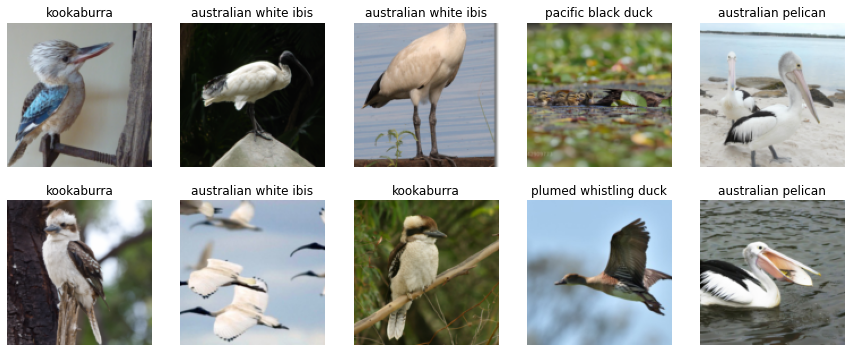

In [34]:
dls.valid.show_batch(max_n=10, nrows=2)

Squishing large images to fit into the size of the image

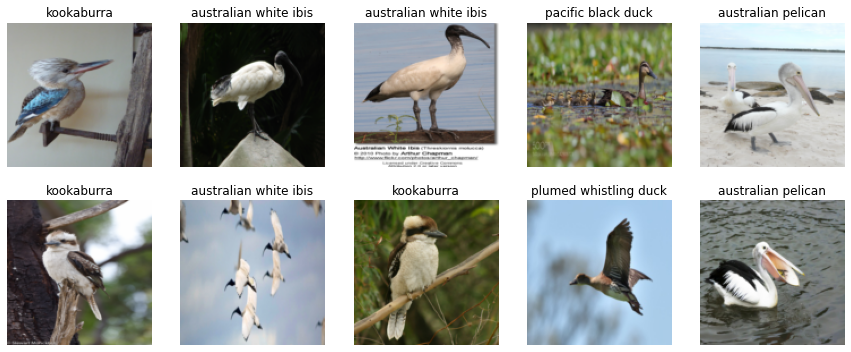

In [35]:
birds = birds.new(item_tfms=Resize(128, ResizeMethod.Squish))
dls = birds.dataloaders(path)
dls.valid.show_batch(max_n=10, nrows=2)

Padding the image borders so they fit

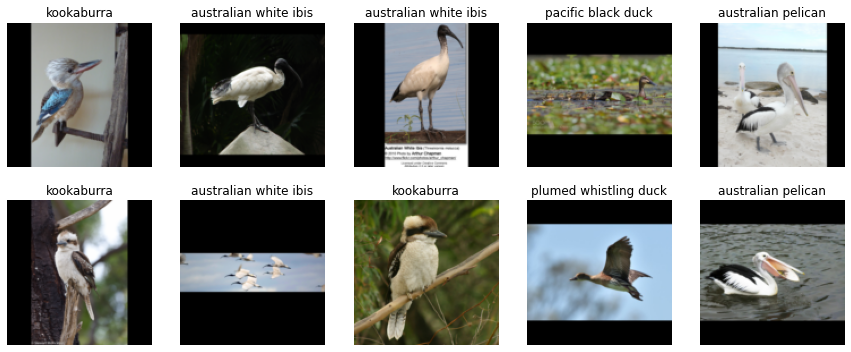

In [36]:
birds = birds.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = birds.dataloaders(path)
dls.valid.show_batch(max_n=10, nrows=2)

Randomly resizing images to allow it to learn on specific parts of an image during epoch

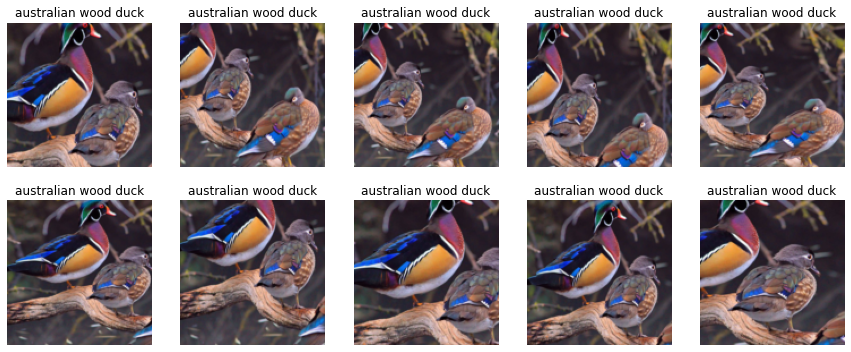

In [37]:
birds = birds.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = birds.dataloaders(path)
dls.train.show_batch(max_n=10, nrows=2, unique=True)

Starting the data augmentation step here, which does a randomization of all three previous steps.
> TODO: Add the individual keywords for image rotation, flipping, perspective warping, brightness changes and contrast changes.

/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:1023: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  /pytorch/aten/src/ATen/native/BatchLinearAlgebra.cpp:760.)
  ret = func(*args, **kwargs)


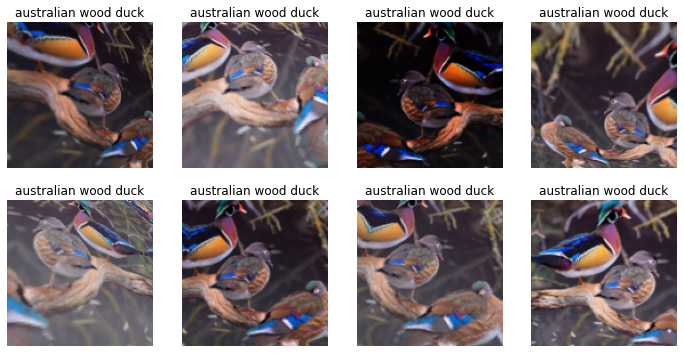

In [38]:
birds = birds.new(item_tfms=Resize(128), batch_tfms=aug_transforms(mult=2))
dls = birds.dataloaders(path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

Putting it all together now to train our model

In [42]:
birds = birds.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = birds.dataloaders(path)

In [43]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.692304,0.229488,0.078035,00:46


epoch,train_loss,valid_loss,error_rate,time
0,0.362119,0.178386,0.072254,00:47
1,0.267956,0.136552,0.046243,00:46
2,0.220220,0.170266,0.049133,00:47
3,0.163554,0.166847,0.049133,00:47


Take a look at how well it did

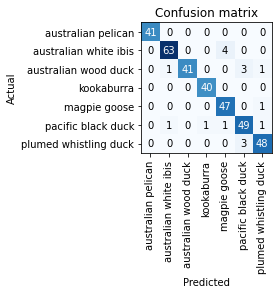

In [44]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

Let's see where it went wrong

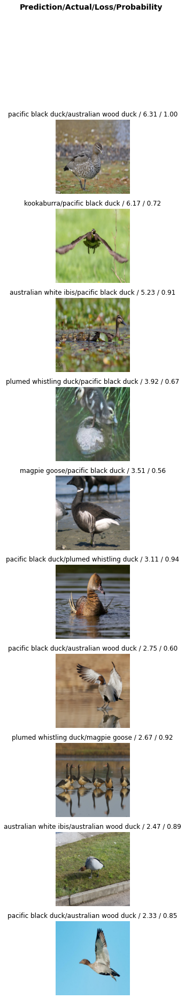

In [46]:
interp.plot_top_losses(10, nrows=10)

If I missed some categorization pre-training, now I can use the code from the book to fix these mistakes here

In [47]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [49]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

I can now re-run the learner with the fixed dataset and see if that helps improve anything. I removed the young birds which looked starkly different to adults, as well as some pictures of eggs that were in the data, and some drawings that were not photos

In [50]:
learn.fine_tune(2)

epoch,train_loss,valid_loss,error_rate,time
0,0.085772,0.138853,0.043353,00:47


epoch,train_loss,valid_loss,error_rate,time
0,0.070127,0.155185,0.034682,00:48
1,0.078726,0.142527,0.043353,00:47


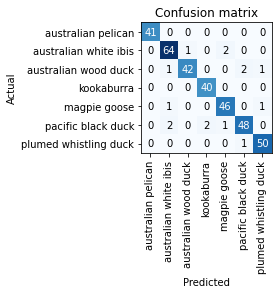

In [51]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

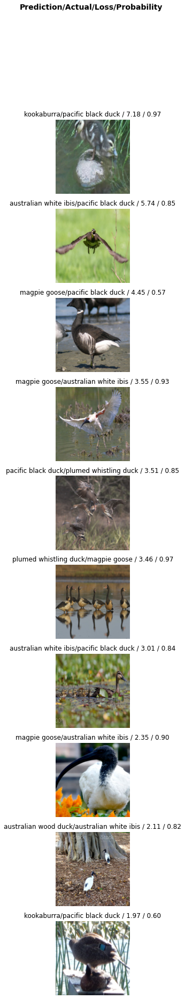

In [52]:
interp.plot_top_losses(10, nrows=10)

Possible improvement notes:
- I need to learn what these birds actually look like by definition so I can fix the training data better
- I may be running fine tune too many times as it seems to be starting to overfit, but need to read up more on this
- Learning from my [hummingbird app](https://hummingbirds.azurewebsites.net) experience I need to investigate if male and female of a species have distinguishing characteristics that require them to have separate categories to allow for better training, as well as looking at chicks/ducklings/young birds characteristics since these may also be very different from how an adult in the species looks

## Next steps
- Go through the steps for exporting the model and publishing to Binder